# ツリーマップ

**ツリーマップ** （**Tree Map**） とは、 **階層構造（ツリー構造）を持つ** 質的変数に対して、その内訳を **長方形の面積** で表現する可視化手法です。
特に、三種類以上の階層的な構造を持つ質的変数の組み合わせを可視化する際に強力です。
一方で、あくまでも面積による表現ですので、要素同士を定量的に比較することは難しいという欠点もあります。

![](../images/07/tree.png)

上図の[発売曜日別・ゲームプラットフォーム別のゲームパッケージ数を表現した例](tree-gm-example)を用いて説明します。
ツリーマップは、複数の階層を持つ質的変数に対応する量的変数の数量を、長方形の面積で表現します。
例えば、上図では一つ目の質的変数である発売曜日（例：「木」曜日）ごとに、そのゲームパッケージ数に応じた **大きさ** の長方形が配置されています。
さらにその長方形の中に、二つ目の質的変数であるゲームプラットフォーム（例：「ニンテンドーDS」）ごとに、そのゲームパッケージ数に応じた長方形が配置されます。
階層が増えるたびに再帰的に長方形を配置することが可能ですので、質的変数の数に理論的な上限値はありません。

[モザイクプロット](./mosaic.ipynb)も同様に長方形の面積を用いて量的変数の数量を表現しますが、ツリーマップは以下の点が異なります。
- モザイクプロットが対象とする質的変数は最大二つだったが、ツリーマップが対象とする質的変数の数に上限はない
- モザイクプロットでは二つの質的変数の組合せによって可視化対象の全ての部分集合を網羅しなければならなかったが、ツリーマップではそのような制限はなく複雑な階層構造を表現可能

上記については、[マンガデータによる可視化例](mosaic-cm)で具体例を用いて説明します。

Plotlyでは、`plotly.express.treemap`でツリーマップを作成可能です。

```python
# plotly.expressモジュールをpxという名前でインポート
# 簡単にインタラクティブな図を作成するためのモジュール
import plotly.express as px

# px.treemap関数を使用して、ツリーマップを作成
# データフレームdfのcol_1列とcol_2列の組み合わせに対して
# col_values列の数量を長方形の大きさで表現する
# 作成した図はfigというオブジェクトに保存される
fig = px.treemap(
    df,
    path=[
        "col_0",
        "col_1",
    ],
    values="col_values",
)
```

## 初期設定

以降では、マンガ・アニメ・ゲームデータを可視化するための初期設定を行います。 なお、紙幅の都合のため、書籍版と一部構成が異なることにご注意ください。

### Import

必要なライブラリをImportします。

In [2]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [3]:
# itertoolsモジュールのインポート
# 効率的なループを実行するためのイテレータビルディングブロックを提供
# これにより、データのコンビネーションや順列などを簡潔に表現できる
import itertools

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

なお、型ヒントについては[こちら](type-hint)を参照ください。

### 定数

本Notebookで用いる定数を定義します。
なお、Pythonにおける定数の扱いについては、[こちら](python-const)を参照ください。

In [4]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = DIR_CM.parent / "output" / Path.cwd().parts[-1] / "tree"
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = DIR_AN.parent / "output" / Path.cwd().parts[-1] / "tree"
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = DIR_GM.parent / "output" / Path.cwd().parts[-1] / "tree"

In [5]:
# 読み込み対象ファイル名の定義

# マンガ作品とマンガ作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# アニメ作品と原作者の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [6]:
# 可視化に関する設定値の定義

# 「年代」の集計単位
UNIT_YEARS = 10

In [7]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

In [8]:
# 国内主要ゲームメーカーのプラットフォームとメーカー名の対応辞書
# キー: プラットフォーム名、値: メーカー名の略称
PF2MK = {
    "プレイステーション": "ソニー",
    "プレイステーション2": "ソニー",
    "プレイステーション・ポータブル": "ソニー",
    "プレイステーション3": "ソニー",
    "プレイステーションVita": "ソニー",
    "プレイステーション4": "ソニー",
    "ゲームアーカイブス": "ソニー",
    "SG-1000": "セガ",
    "SC-3000": "セガ",
    "SEGAマーク3": "セガ",
    "セガ・マスターシステム": "セガ",
    "メガドライブ": "セガ",
    "ゲームギア": "セガ",
    "セガサターン": "セガ",
    "ドリームキャスト": "セガ",
    "ファミリーコンピュータ": "任天堂",
    "ゲームボーイ": "任天堂",
    "スーパーファミコン": "任天堂",
    "NINTENDO64": "任天堂",
    "ゲームボーイアドバンス": "任天堂",
    "ニンテンドーゲームキューブ": "任天堂",
    "ニンテンドーDS": "任天堂",
    "ニンテンドー3DS": "任天堂",
    "Wii": "任天堂",
    "WiiU": "任天堂",
    "NintendoSwitch": "任天堂",
}

In [10]:
# pandasのweekday関数で取得できる曜日の数値と実際の曜日名を対応させる辞書を定義
# 0:月曜日, 1:火曜日, ... , 6:日曜日
WEEKDAY2YOBI = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [11]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

### 関数

以下では、本Notebookで用いる関数を定義します。

In [12]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [13]:
def add_years_to_df(
    df: pd.DataFrame, unit_years: int = UNIT_YEARS, col_date: str = "date"
) -> pd.DataFrame:
    """
    データフレームにunit_years単位で区切った年数を示す新しい列を追加

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    unit_years : int, optional
        年数を区切る単位、デフォルトはUNIT_YEARS
    col_date : str, optional
        日付を含むカラム名、デフォルトは "date"

    Returns
    -------
    pd.DataFrame
        新しい列が追加されたデータフレーム
    """

    # 入力データフレームをコピー
    df_new = df.copy()

    # unit_years単位で年数を区切り、新しい列として追加
    df_new["years"] = (
        pd.to_datetime(df_new[col_date]).dt.year // unit_years * unit_years
    )

    # 'years'列のデータ型を文字列に変更
    df_new["years"] = df_new["years"].astype(str)

    return df_new

In [14]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

### マンガデータ

マンガ各話数を例に、可視化手法を説明します。

In [15]:
# pandasのread_csv関数でCSVファイルの読み込み
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)

In [16]:
# 可視化用の前処理のためデータフレームをコピー
df_cm = df_cc_crt.copy()

# 可視化対象として利用する列とその表示名
cols_cm = {
    "mcname": "マンガ雑誌名",
    "crtname": "マンガ作者名",
    "ccname": "マンガ作品名",
    "n_ce": "マンガ各話数",
}

# 可視化対象の列のみ抽出
df_cm = df_cm[cols_cm.keys()]

# 列名をわかりやすく変更
df_cm = df_cm.rename(columns=cols_cm)

In [17]:
# 可視化対象のDataFrameを確認
df_cm.head()

,マンガ雑誌名,マンガ作者名,マンガ作品名,マンガ各話数
0,週刊少年ジャンプ,山止たつひこ,交通安全'76,1
1,週刊少年ジャンプ,柳田東一郎,好敵手 室伏広治物語,1
2,週刊少年ジャンプ,門脇正法,好敵手 室伏広治物語,1
3,週刊少年ジャンプ,富沢順,鋼鉄の殺人者,1
4,週刊少年ジャンプ,本宮ひろ志,硬派山崎銀次郎,1


In [18]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../data/cm/output/07/tree/cm.csv'.


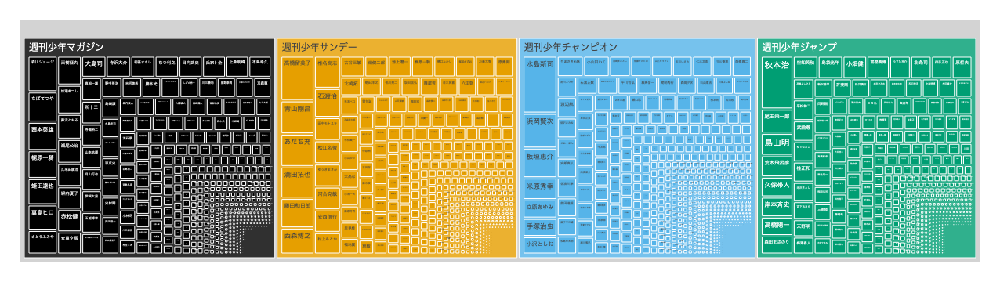

In [19]:
# px.treemapでツリーマップを作成
# df_cmに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_cm, path=["マンガ雑誌名", "マンガ作者名"], values="マンガ各話数", color_discrete_sequence=OKABE_ITO
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、マンガ雑誌別のマンガ作者の合計マンガ各話数を表現したツリーマップです。
合計マンガ各話数の量を長方形の面積で表現しています。
例えば、`週刊少年マガジン`においては、`森川ジョージ`さん、`ちばてつや`さん、`西本英雄`さんの順に合計マンガ各話数が多いことがわかります。
また、マンガ雑誌同士の合計マンガ各話数の大きさも比較することが可能ですが、それぞれほぼ同じ値のため、ひと目でその差を見分けることは難しいです。

なお、今回は情報の網羅性を重視し、複数のマンガ雑誌に掲載経験のあるマンガ作者を除外していません[^pie]。
つまり、複数のマンガ雑誌に重複して登場するマンガ作者も含まれることにご注意ください。
マンガ作者の重複を回避したい場合は、[円グラフ](pie-cm)等と同様、事前にデータをフィルタリングすると良いでしょう。

[^pie]: [円グラフ](pie-cm)、[棒グラフ](propbar-cm)、[積上げ密度プロット](area-cm)、そして[モザイクプロット](mosaic-cm)では除外していました。

同様の表現は他の可視化手法でも可能ですが、ツリーマップの強みはその **高い一覧性** にあります。
例えば棒グラフを用いた場合、[一度に表現できるマンガ作者数はたかだか20程度](bar-cm)です。
ツリーマップを用いた場合、（マンガ各話数が小さいマンガ作者名は判読できません[^existence]が）100以上のマンガ作者を同時に表現することが可能になります。
探索的なデータ分析の初手として全体を俯瞰したいとき、特に効果的な手段になるでしょう。

[^existence]: 水準名を判読できないほど小さい長方形で表現しても意味がないのでは、と疑問に思う方もいるかもしれません。しかし、分析の初期段階では、水準数とその大小関係を俯瞰することで分析のヒントを得られることが多々あります。

ツリーマップの弱みの一つは、視覚的な比較を可能にする基準を矩形同士が共有しているとは限らないため、異なる条件間の直接比較が困難である{cite}`claus2019`という点です。
例えば、`森川ジョージ`さんと`ちばてつや`さんは一辺を共有しているため面積の比較が容易ですが、`ちばてつや`さんと`さとうふみや`さんの比較は困難です。
遠くに配置された矩形同士であるほど、より比較が困難になります。

ツリーマップと類似する可視化手法として[モザイクプロット](./mosaic.ipynb)があります。
ただし、モザイクプロットでは、二つの質的変数の組み合わせによって、可視化対象の全ての部分集合を網羅できるという前提条件が必要でした。
例えば、[マンガデータの例](mosaic-cm)では、年代とマンガ雑誌を特定することで全てのマンガ作者を表現可能でした。
一方でツリーマップにはそのような前提条件は不要です。

さらに、ツリーマップでは三階層以上の構造も可視化可能です。

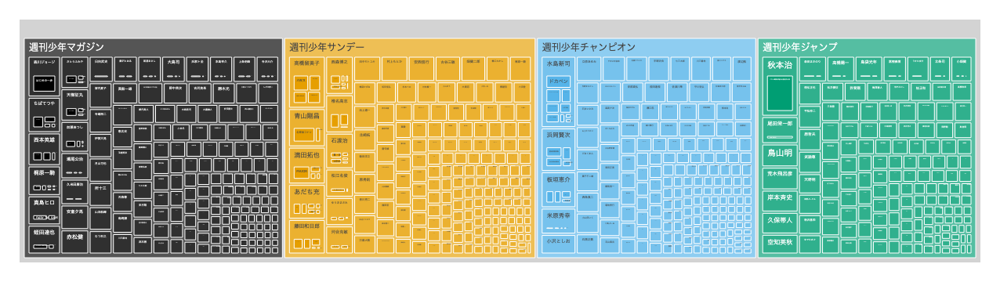

In [20]:
# px.treemapでツリーマップを作成
# df_cmに対して、pathの順序でツリーの階層を構築（先程と比較して、マンガ作品名を追加）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
# なお、表示が細かくなりすぎないよう、各話数が50以上のマンガ作品に限定
fig = px.treemap(
    df_cm[df_cm["マンガ各話数"] >= 50],
    path=["マンガ雑誌名", "マンガ作者名", "マンガ作品名"],
    values="マンガ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、マンガ雑誌、マンガ作者、そしてそのマンガ作品別のマンガ各話数を表したツリーマップです。
直前の図と比較し、マンガ作品に関する情報が追加されました。
これにより、各マンガ作者のマンガ各話数の内訳をより具体的に理解できるようになりました。
例えば、`森川ジョージ`さんの`1186`話は`はじめの一歩`一作で構成されていますが、`ちばてつや`さんの`1032`話は複数のマンガ作品で構成されています。

なお、上図では複数のマンガ作者の共同名義で作成されたマンガ作品に対して、特に処理を行っていません。
つまり、
**マンガ作品が重複してカウントされている場合がある**
ことにご注意ください。

### アニメデータ

アニメ各話数を例に、可視化手法を説明します。

In [21]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)

In [22]:
# 可視化用の集計
# df_ac_actをコピー
df_an = df_ac_act.copy()

# 各声優が本データ中に最初に登場した年を集計
df_an["first_date"] = pd.to_datetime(df_an["first_date"])
# actname2fyearに声優名を初登場年の対応関係を格納
actname2fyear = df_an.groupby("actname")["first_date"].first().dt.year.to_dict()
# df_anの`first_year`列に声優としての初登場年を追加
df_an["first_year"] = df_an["actname"].map(actname2fyear)

# 可視化に用いる列とその表示名
cols_an = {
    "acname": "アニメ作品名",
    "n_ae": "アニメ各話数",
    "actname": "声優名",
    "gender": "性別",
    "first_year": "初登場年",
}
# 可視化に用いる列のみ残す
df_an = df_an[cols_an.keys()]
# 可視化用に列名を変更
df_an = df_an.rename(columns=cols_an)

In [23]:
# 可視化対象のDataFrameを確認
df_an.head()

,アニメ作品名,アニメ各話数,声優名,性別,初登場年
0,ギャラクシー エンジェル,24,かないみか,female,2001
1,ギャラクシー エンジェル,24,保村真,male,2001
2,ギャラクシー エンジェル,24,吉野裕行,male,2001
3,ギャラクシー エンジェル,24,山口眞弓,female,2001
4,ギャラクシー エンジェル,24,新谷良子,female,2001


In [24]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../data/an/output/07/tree/an.csv'.


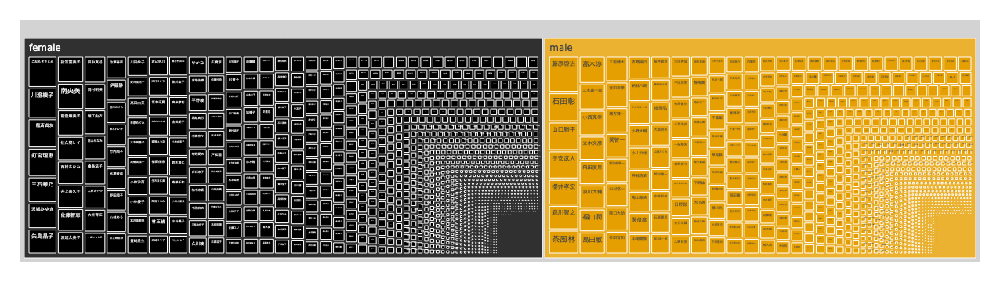

In [25]:
# px.treemapでツリーマップを作成
# df_anに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_an, path=["性別", "声優名"], values="アニメ各話数", color_discrete_sequence=OKABE_ITO
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、性別[^gender]別、声優別のアニメ各話数を表現したツリーマップです。
女性声優としては`こおろぎさとみ`さんが最も多く、男性声優としては`藤原啓治`さんが最も多いことがわかります。

[^gender]: この分析では、性別を男性と女性という形で区分けしていますが、これは単に分析の手法上の選択です。筆者は、性別の多様性を深く尊重しており、多様な性自認や表現を含めた性のスペクトラム全体を認識しています。この文脈での性別の使用は、あくまで分析の枠組みを単純化するためのものであり、特定の性別認識の排除や無視を意図するものではありません。

では、彼らは具体的にどのようなアニメ作品に出演していたのでしょうか？
データサイズの都合上、全ての声優についてアニメ作品を可視化することはできないため、合計アニメ各話数が多い上位100名に絞ります。

In [26]:
# データサイズを圧縮するため、合計アニメ各話数が多い100名の声優を抽出

# 声優名別の合計アニメ各話数を集計し、df_tmpとして格納
df_tmp = df_an.groupby("声優名")["アニメ各話数"].sum().reset_index()
# 合計アニメ各話数で降順にソート
df_tmp = df_tmp.sort_values("アニメ各話数", ascending=False, ignore_index=True)
# 上位100名の声優名を抽出し、リストとして格納
actnames = df_tmp["声優名"].head(100).unique().tolist()

# 上記の声優名リストに含まれるレコードのみ抽出
df_an2 = df_an[df_an["声優名"].isin(actnames)].reset_index(drop=True)

In [27]:
# 可視化対象のDataFrameを確認
df_an2.head()

,アニメ作品名,アニメ各話数,声優名,性別,初登場年
0,ギャラクシー エンジェル,24,吉野裕行,male,2001
1,ギャラクシー エンジェル,24,沢城みゆき,female,2001
2,ギャラクシー エンジェル,24,田村ゆかり,female,2001
3,ギャラクシー エンジェル,24,藤原啓治,male,2001
4,ギャラクシー エンジェル,24,陶山章央,male,2001


In [28]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an2, DIR_OUT_AN, "an2")

DataFrame is saved as '../../data/an/output/07/tree/an2.csv'.


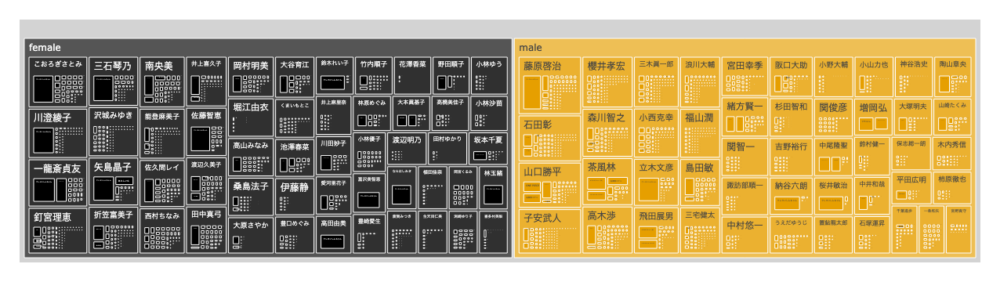

In [29]:
# px.treemapでツリーマップを作成
# df_anに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_an2,
    path=["性別", "声優名", "アニメ作品名"],
    values="アニメ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、性別別、声優別、アニメ作品別のアニメ各話数を表現したツリーマップです。
特に`クレヨンしんちゃん`に紐付けられた声優が目立つことがわかります。
本データの仕様上、声優は **アニメ各話** ではなく **アニメ作品** に対応付けられています。
長寿作品に対応付けられた声優は、たとえ全話に登場していなくとも、上図中でのアニメ各話数は多くなる傾向にあることにご注意ください。

また、アニメデータ特有の事情として、しばしば一つのアニメ作品に複数の声優が対応付けられることがあります。
今回は特に事前に対応していないため、
**アニメ作品が重複してカウントされていることがある**
ことに注意しましょう。

### ゲームデータ

ゲームパッケージ数を例に、可視化手法を説明します。

In [30]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [31]:
# 曜日ごとのパッケージ数を集計するためのデータ前処理

# date列をdatetimeオブジェクトに変換して、曜日情報を新たな列としてdf_pkg_pfに追加
df_pkg_pf["weekday"] = pd.to_datetime(df_pkg_pf["date"]).dt.weekday

# 曜日ごとにユニークなパッケージIDの数を集計
df_gm = (
    df_pkg_pf.groupby(["pfname", "weekday", "publisher"])["pkgid"]
    .nunique()
    .reset_index(name="n_pkg")
)

# 数値で表されている曜日を文字列にマッピング
df_gm["yobi"] = df_gm["weekday"].apply(lambda x: WEEKDAY2YOBI.get(x, None))

# 列名をリネーム
df_gm = df_gm.rename(
    columns={
        "n_pkg": "パッケージ数",
        "yobi": "曜日",
        "pfname": "プラットフォーム名",
        "publisher": "パブリッシャー名",
    }
)

In [32]:
# 可視化対象のDataFrameを確認
df_gm.head()

,プラットフォーム名,weekday,パブリッシャー名,パッケージ数,曜日
0,3DO,0,株式会社ワープ,2,月
1,3DO,2,株式会社マイクロキャビン,1,水
2,3DO,2,株式会社マイクロネット,2,水
3,3DO,2,株式会社リバーヒルソフト,1,水
4,3DO,3,イマジニア株式会社,1,木


In [33]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../data/gm/output/07/tree/gm.csv'.


(tree-gm-example)=

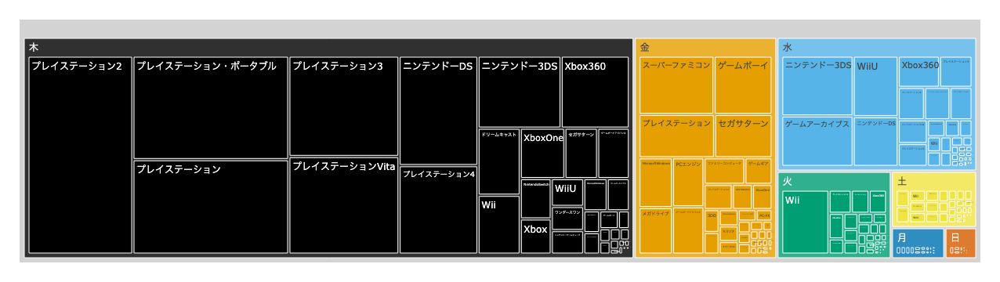

In [34]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm,
    path=["曜日", "プラットフォーム名"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、発売曜日ごと、ゲームプラットフォームごとのゲームパッケージ数を表現したツリーマップです。
全体として`木`曜に発売されたゲームパッケージが最も多く、中でも`プレイステーション2`向けのものが最も多くの割合を占めていたことがわかります。
次いで`金`曜に発売されたゲームパッケージが多く、`スーパーファミコン`や`ゲームボーイ`が多くの割合を占めたようです。

では、ゲームプラットフォームと発売曜日の階層を逆転させてみましょう。

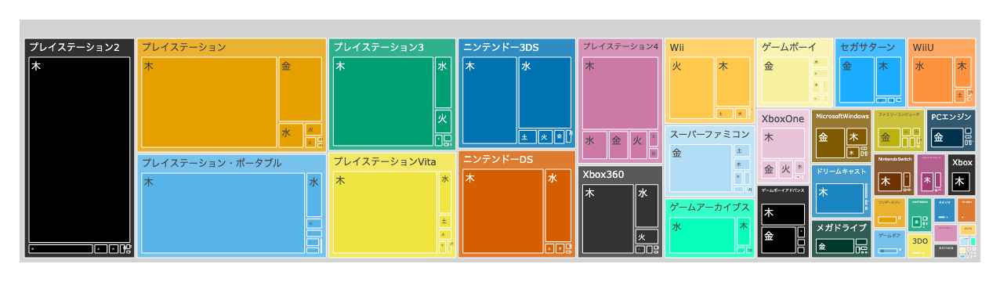

In [35]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築（プラットフォーム名と曜日の順序を変更）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm,
    path=["プラットフォーム名", "曜日"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

各ゲームプラットフォーム内における、発売曜日の割合がわかりやすくなりました。

では、メーカー[^sony]別のゲームパッケージ数はどうなっているのでしょうか？

[^sony]: 2023年12月29日の本書執筆時点において、ソニーグループのビデオゲーム・デジタルエンタテインメント企業は「ソニー・インタラクティブエンタテインメント」ですが、本分析では便宜上「ソニー」という略称を用います。

In [36]:
# データサイズを圧縮するため、PF2MKに含まれるプラットフォームのみ抽出
df_gm2 = df_gm[df_gm["プラットフォーム名"].isin(PF2MK.keys())].reset_index(drop=True)
# pf2mkを利用し、df_gm2にメーカー名列を追加
df_gm2["メーカー名"] = df_gm2["プラットフォーム名"].map(PF2MK)

In [37]:
# 可視化対象のDataFrameを確認
df_gm2.head()

,プラットフォーム名,weekday,パブリッシャー名,パッケージ数,曜日,メーカー名
0,NINTENDO64,0,任天堂株式会社,2,月,任天堂
1,NINTENDO64,1,任天堂株式会社,2,火,任天堂
2,NINTENDO64,1,株式会社メディアファクトリー,1,火,任天堂
3,NINTENDO64,2,コナミ株式会社,2,水,任天堂
4,NINTENDO64,2,任天堂株式会社,4,水,任天堂


In [38]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm2, DIR_OUT_GM, "gm2")

DataFrame is saved as '../../data/gm/output/07/tree/gm2.csv'.


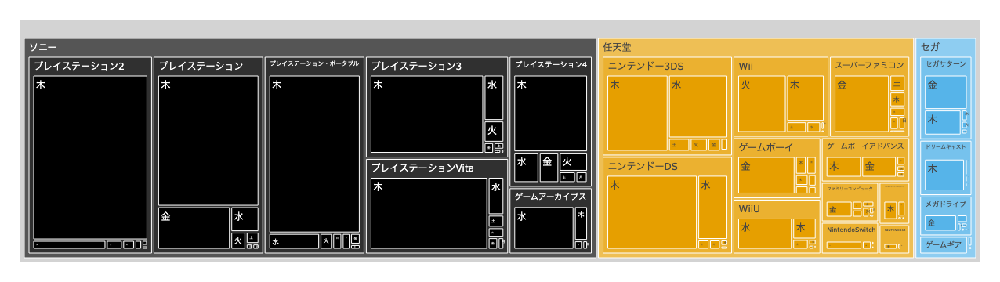

In [39]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築（プラットフォーム名と曜日の順序を変更）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm2,
    path=["メーカー名", "プラットフォーム名", "曜日"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

上図は、メーカーごと、ゲームプラットフォームごと、発売曜日ごとのゲームパッケージ数を表現したツリーマップです。

- `ソニー`：ほとんどのゲームプラットフォーム向けのゲームパッケージは、`木`曜日に発売されている。ただし、`プレイステーション`はやや`金`曜の比率が他のプラットフォームより多く、`ゲームアーカイブス`は`水`曜が最も多い
- `任天堂`：`木`曜、`水`曜、あるいは`金`曜発売のゲームパッケージが多い
- `セガ`：`金`曜、あるいは`木`曜発売のゲームパッケージが多い

ということがわかります。